# Orca Classification using RNN
In this jupyter notebook I will present two simple RNN models for Orca Call classification. The only difference between these models is that one of them uses spectrograms as input and other one works on raw data.

Download raw data from here: https://drive.google.com/open?id=1wSJ4qoYZjOat3A9cE_py-HqRSRa5WMlV (Required if you want to generate your data for training).

Let's get started by importing some packages.

In [1]:
import numpy as np
from pydub import AudioSegment
import os
# from td_utils import *
import numpy as np
import matplotlib.pyplot as plt
from scipy.io import wavfile
from scipy.misc import imread
import matplotlib.ticker as plticker
from matplotlib import mlab, cm
import shutil
%matplotlib inline

C:\Users\Babban\AppData\Local\conda\conda\envs\tensorflow\lib\site-packages\pydub\utils.py:165: RuntimeWarning: Couldn't find ffmpeg or avconv - defaulting to ffmpeg, but may not work
  warn("Couldn't find ffmpeg or avconv - defaulting to ffmpeg, but may not work", RuntimeWarning)


First I will create two dictionaries which we will be using in our program.

* `labelDict` - maps positive audio to it's label class.
* `label_to_num` - maps every label to a number.

In [2]:
labelDict = {"0": "weeya",
	"1": "weeya",
	"2": "weeya",
	"3": "weeya",
	"4": "weeya",
	"5": "a",
	"6": "updownup",
	"7": "richochet",
	"8": "richochet",
	"9": "richochet",
	"10": "a",
	"11": "c",
	"12": "b",
	"13": "weeya",
	"14": "updownup",
	"15": "updownup",
	"16": "updownup",
	"17": "swoop",
	"18": "updownup"
}

label_to_num = {}
for i,val in enumerate(set(labelDict.values())):
    label_to_num[val] = i
    
label_to_num["negative"] = len(label_to_num)
label_to_num

{'a': 1,
 'b': 0,
 'c': 6,
 'negative': 7,
 'richochet': 3,
 'swoop': 4,
 'updownup': 5,
 'weeya': 2}

### Prepare Backgrounds

Let us first prepare 1 second backgrounds from available data.

In [3]:

#Prepare BGS
def get_random_time_segment_for_BG(high, length):
    """Generates random time segment of length 'length' in range of 0 and high.
    
    args:
    high- upper bound of range.
    length- length of time segment.
    
    returns:
    segment_start- start time of segment.
    segment_end- end time of segment.
    """
    
    length = length*1000
    segment_start = np.random.randint(low=0, high=high-length)   # Make sure segment doesn't run past the 10sec background 
    segment_end = segment_start + length
    
    return (segment_start, segment_end)


for file in os.listdir("./backgrounds/"):
    if file.endswith(".wav"):
        bg = AudioSegment.from_wav("./backgrounds/"+file)
        segment_start, segment_end = get_random_time_segment_for_BG(len(bg), 1)
        bg = bg[segment_start:segment_end]
#         print(len(bg))
        if not os.path.exists("./finalData/backgrounds/"):
            os.makedirs("./finalData/backgrounds/")
        bg.export("./finalData/backgrounds/"+file, format='wav')

Now let's define some functions which we will be using to prepare our dataset

In [4]:

def graph_spectrogram(wav_file):
    """Generates and returns a spectrogram for a wav file. Right now upto 2 input channels are supported."""
    rate, data = wavfile.read(wav_file)
    fig,ax = plt.subplots(1)
    fig.subplots_adjust(left=0,right=1,bottom=0,top=1)
    ax.axis('off')
    plt.set_cmap('magma')
    nchannels = data.ndim
    if nchannels ==1:
        pxx, freqs, bins, im = ax.specgram(x=data, Fs=rate, noverlap=120, NFFT=200)
    if nchannels ==2:
        pxx, freqs, bins, im = ax.specgram(x=data[:,0], Fs=rate, noverlap=120, NFFT=200)
    ax.axis('off')
    return pxx, freqs, bins

In [5]:
def get_random_time_segment(high, length):
    """Returns a tuple of time segment of length-'length'. 
    Here length < high.
    
    returns:
    a tuple containing
    segment_start - start time of segment
    segment_end - end time of segment"""
    
    segment_start = np.random.randint(low=0, high=high-length)   # Make sure segment doesn't run past the high 
    segment_end = segment_start + length
    
    return (segment_start, segment_end)

In [6]:
def insert_audio_clip(background, audio_clip):
    """Overlays audio clip to the background at random time segment.
    
    returns:
    new_background - final audio clip
    segment_time - tuple of time segment"""
    segment_ms = len(audio_clip)
    segment_time = get_random_time_segment(len(background), segment_ms)
    new_background = background.overlay(audio_clip, position = segment_time[0])
    
    return new_background, segment_time

## Data preparation
Now I will prepare data for our models. Dataset will consist of examples of all 8 classes with labels. All samples are of 1 second in length. 

Data will be stored in two formats:
* Spectrograms in .npy file- Used by first model.
* Audio (.wav) files- Used by second RNN model.


Most of the steps used in preparation of data here are same as of CNN classifier's data preparation. The difference here is the I'm not using preprocessing techniques like contrast enhancement, histogram equilization etc. That's because the dataset is too small to see effects of these techniques on our model.

Let's start by loading path of raw data

In [7]:

files = []
for file in os.listdir("./negativeTesting/"):
    if file.endswith(".wav"):
        files.append(file)
        
bgs = []
for file in os.listdir("./finalData/backgrounds/"):
    if file.endswith(".wav"):
        bgs.append(file)

The following code performs the following tasks.

1. Loads a negative file randomly.

    1.1. If length of file is more than 1 sec. Then it selects random 1 sec segment from it. 
    
    1.2. If length is less than 1 sec. Then is overlays the negative sample file on a randomly selected 1 sec background file.
    
2. After processing the length of our sample the spectrogram is calculates.

3. After all the preprocessing the data is saved in two formats.

    3.1. All the generated audio files are saved in .wav format.
    3.2. Generated Data is also saved in two  `.npy` files.
        3.2.1 `labels.npy`- Labels.
        3.2.2 `specGrams.npy`- spectrogram data.


C:\Users\Babban\AppData\Local\conda\conda\envs\tensorflow\lib\site-packages\matplotlib\pyplot.py:522: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


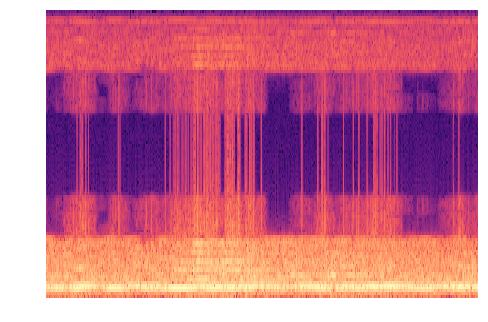

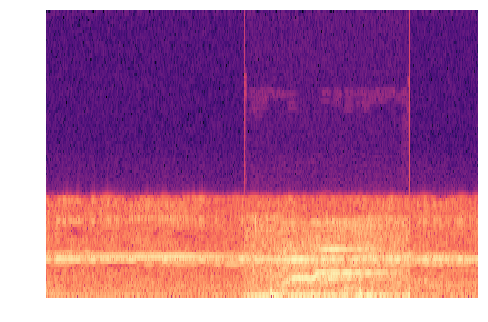

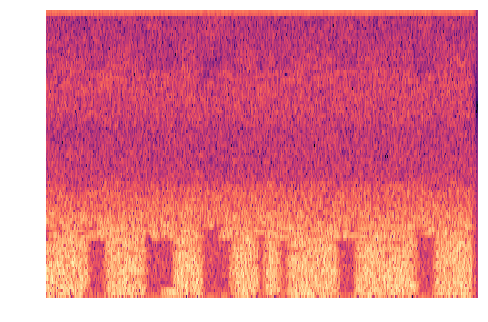

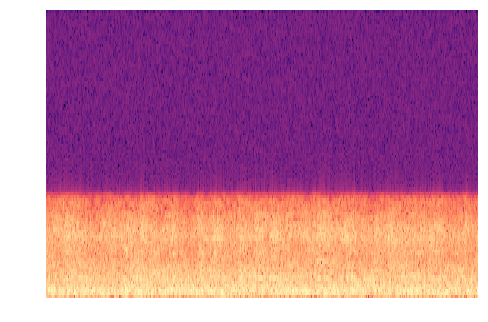

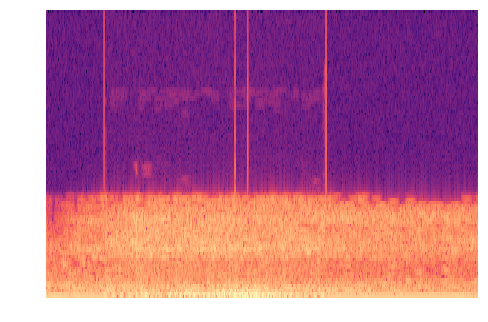

...

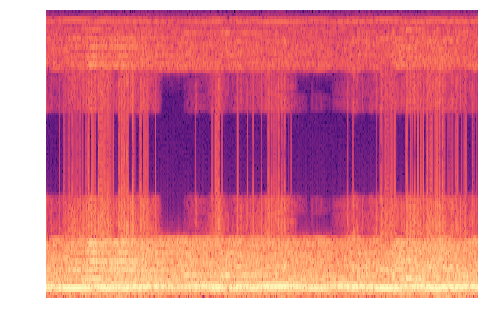

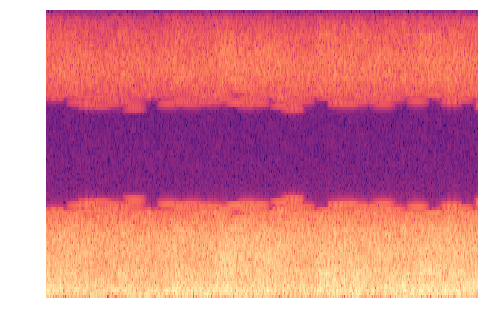

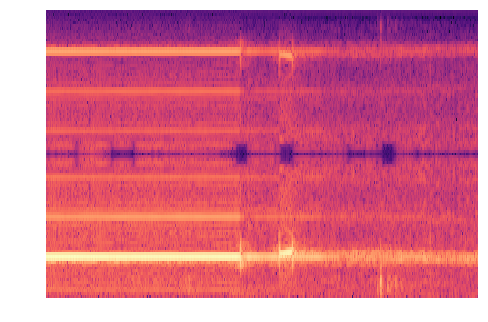

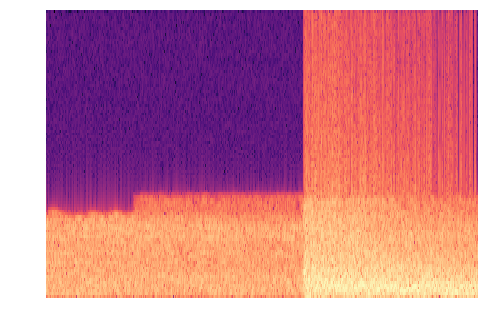

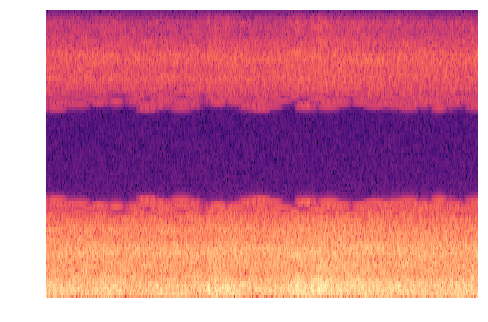

In [8]:
num_samples = 40
neg_train_labels = np.zeros((num_samples))
neg_train_specGram_array = np.zeros((num_samples, 549, 101))

if not os.path.exists("./newData/audio/negative"):
        os.makedirs("./newData/audio/negative")
if not os.path.exists("./newData/images/negative"):
        os.makedirs("./newData/images/negative")
for n in range(num_samples):
    file = files[np.random.randint(0, len(files))]
    audio = AudioSegment.from_wav("./negativeTesting/"+file)
#     print("selected Neg for "+str(n)+ ":" + "./negativeTesting/"+file)
    neg_train_labels[n] = int(label_to_num["negative"])
    if len(audio) >= 1000:
        if len(audio) != 1000:
            segment_start, segment_end = get_random_time_segment(len(audio), 1000)
            audio = audio[segment_start:segment_end]
            audio.export("./newData/audio/negative/"+str(n)+".wav", format='wav')
        else:
            audio.export("./newData/audio/negative/"+str(n)+".wav", format='wav')
    else:
        random_BG_file = bgs[np.random.randint(0, len(bgs))]
        background = AudioSegment.from_wav("./finalData/backgrounds/"+random_BG_file)
        background = background
        audio, _ = insert_audio_clip(background, audio)
        audio.export("./newData/audio/negative/"+str(n)+".wav", format='wav')
    
    P, freqs, bins = graph_spectrogram("./newData/audio/negative/"+str(n)+".wav")
    neg_train_specGram_array[n] = P.T

**Saves our data in memory**

In [9]:
from keras.utils import to_categorical
neg_train_encoded = to_categorical(neg_train_labels, num_classes=8)
np.save("./newData/audio/negative/labels.npy", neg_train_encoded)
np.save("./newData/audio/negative/specGrams.npy", neg_train_specGram_array)

Using TensorFlow backend.


## Positive data
First I want to show what spectrograms generated from my RNN model(model that detects time of orca calls) looks like. All these spectrograms have 1 sec length.

<img src="images/0.jpg"><img src="images/1.jpg">

<img src="images/2.jpg">


So, to get similar training data I will perform 3 types of data augmentation. All the spectrogram transformations described above will be applied in all of the three cases.

* First I will generate data similar to what I did for negative data.This way we will be able to generate data like picture 3 above.


* Secondly, I will crop positive audio to an extent where it will contain only orca call( audio length less than 1 sec). This way I will be able to generate positive data where orca calls will be overlayed on random background time segments.


* Third, in third type of positive data orca calls will be cropped 20%-30% either from beggining or end. Then these will be overlayed either starting or end of the randomly selected background. This way we will be able to generate data like pictures 1 and 2 above.


Let's load path of positive data and generate first type of positive Data.

In [10]:
files = []
for file in os.listdir("./positive/"):
    if file.endswith(".wav"):
        files.append(file)
        
bgs = []
for file in os.listdir("./finalData/backgrounds/"):
    if file.endswith(".wav"):
        bgs.append(file)

06.wav
05.wav
07.wav
04.wav
10.wav
16.wav
09.wav
00.wav
12.wav
01.wav
09.wav
06.wav
09.wav
06.wav
05.wav
06.wav
06.wav
14.wav
18.wav
07.wav
02.wav
13.wav
12.wav
16.wav
05.wav
11.wav
04.wav
10.wav
17.wav


C:\Users\Babban\AppData\Local\conda\conda\envs\tensorflow\lib\site-packages\matplotlib\pyplot.py:522: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


04.wav
08.wav
07.wav
08.wav
04.wav
07.wav
01.wav
08.wav
08.wav
06.wav
05.wav
03.wav
05.wav
13.wav
18.wav
04.wav
04.wav
13.wav
09.wav
09.wav
10.wav
10.wav
06.wav
06.wav
03.wav
09.wav
01.wav
14.wav
06.wav
13.wav
15.wav
08.wav
15.wav
09.wav
02.wav
16.wav
14.wav
10.wav
04.wav
10.wav
12.wav
11.wav
06.wav
03.wav
12.wav
12.wav
10.wav
03.wav
08.wav
03.wav
07.wav
11.wav
11.wav
10.wav
14.wav
07.wav
15.wav
14.wav
03.wav
09.wav
03.wav
01.wav
12.wav
03.wav
02.wav
16.wav
00.wav
06.wav
13.wav
06.wav
14.wav


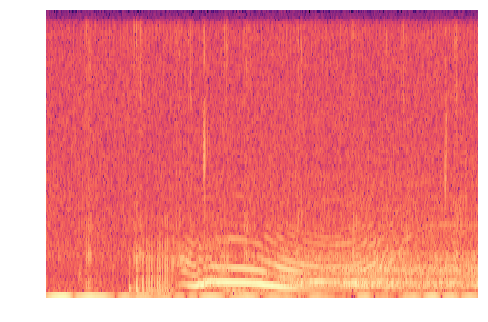

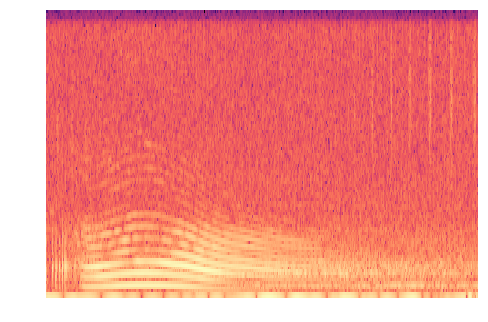

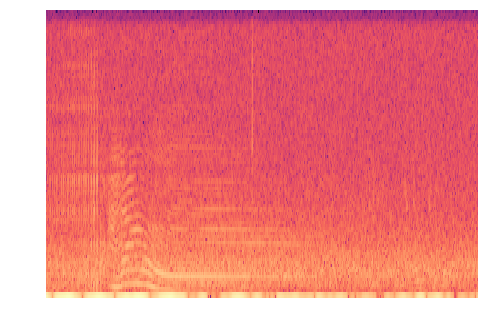

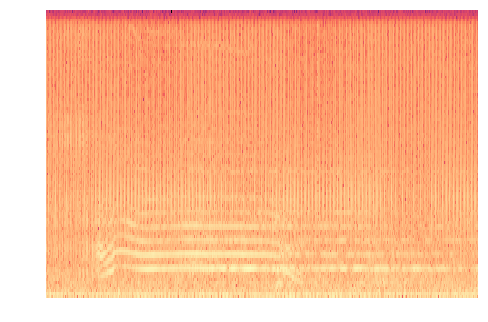

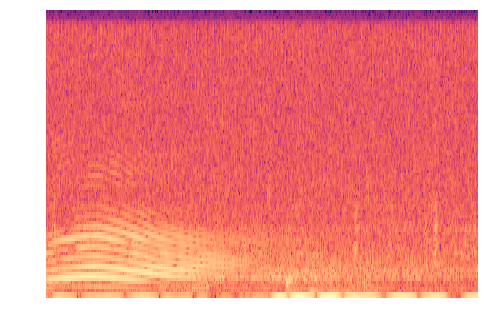

...

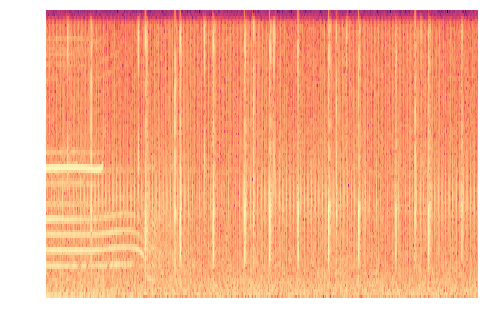

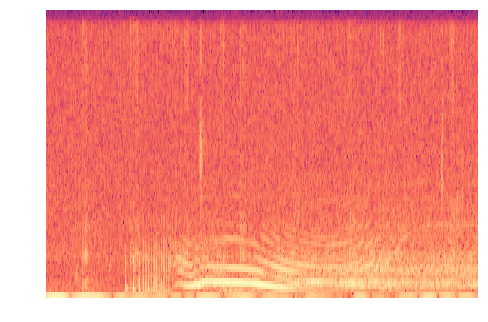

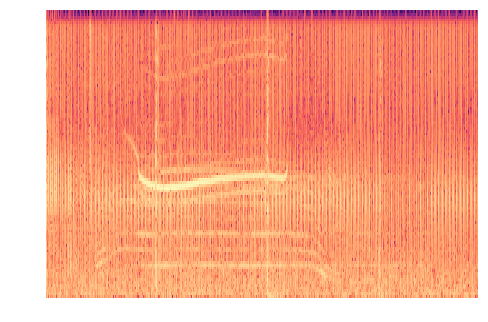

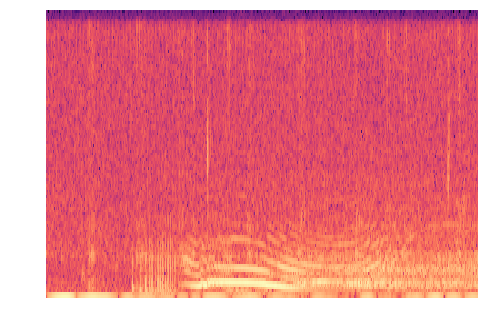

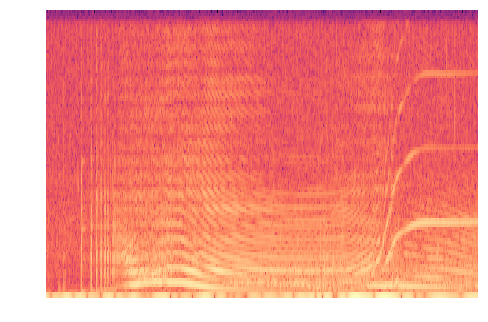

In [11]:
import numpy as np
num_samples = 300
s = num_samples//3
positive_train_labels = np.zeros((num_samples))
positive_train_specGram_array = np.zeros((num_samples, 549, 101))

if not os.path.exists("./newData/audio/positive"):
        os.makedirs("./newData/audio/positive")

for n in range(0, s):
    randNum = np.random.randint(0, len(files))
    file = files[randNum]
    positive_train_labels[n] = int(label_to_num[labelDict[str(randNum)]])
    audio = AudioSegment.from_wav("./positive/"+file)
#     print(file)
    if len(audio) >= 1000:
        if len(audio) != 1000:
            segment_start, segment_end = get_random_time_segment(len(audio), 1000)
            audio = audio[segment_start:segment_end]
            audio.export("./newData/audio/positive/"+str(n)+".wav", format='wav')
        else:
            audio.export("./newData/audio/positive/"+str(n)+".wav", format='wav')
    else:
        random_BG_file = bgs[np.random.randint(0, len(bgs))]
        background = AudioSegment.from_wav("./finalData/backgrounds/"+random_BG_file)
        background = background
        audio, _ = insert_audio_clip(background, audio)
        audio.export("./newData/audio/positive/"+str(n)+".wav", format='wav')
    
    P, freqs, bins = graph_spectrogram("./newData/audio/positive/"+str(n)+".wav")
    positive_train_specGram_array[n] = P.T

**Now lets create Second type of positive data. For this let's load path of super short positive orca calls**.

In [12]:
"""smolpositive contains highly trimmed positive audio data"""
files = []
for file in os.listdir("./smolpositive/"):
    if file.endswith(".wav"):
        files.append(file)
        
bgs = []
for file in os.listdir("./finalData/backgrounds/"):
    if file.endswith(".wav"):
        bgs.append(file)

C:\Users\Babban\AppData\Local\conda\conda\envs\tensorflow\lib\site-packages\matplotlib\pyplot.py:522: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


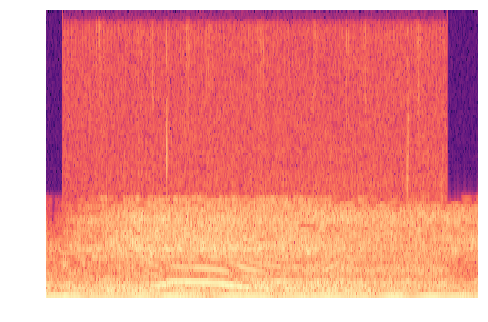

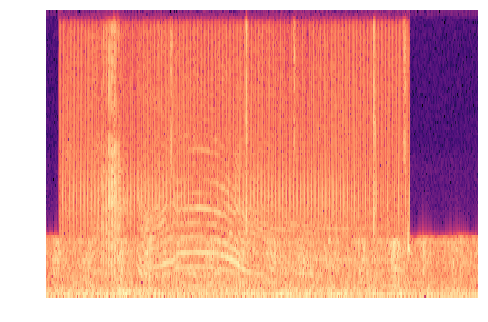

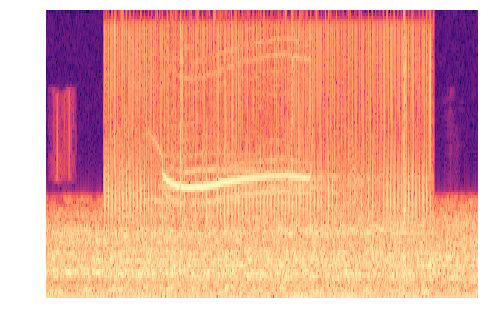

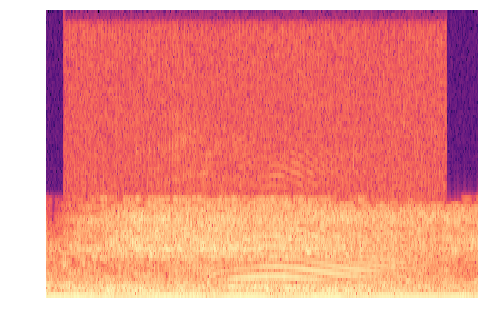

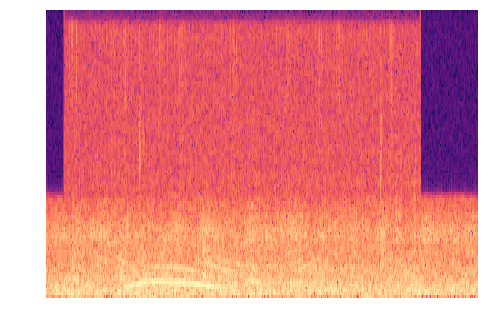

...

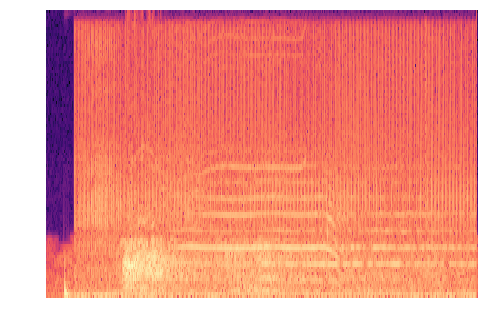

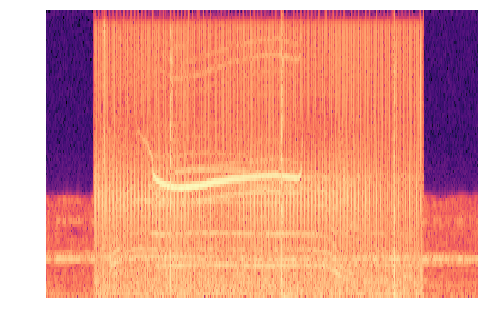

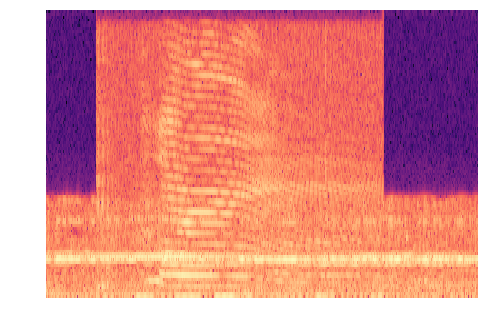

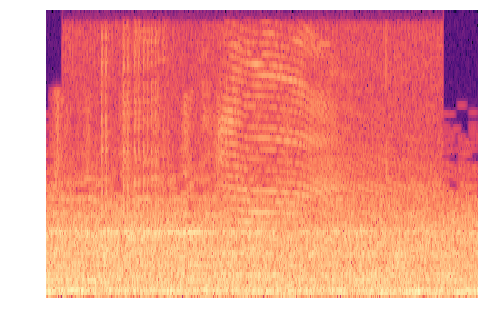

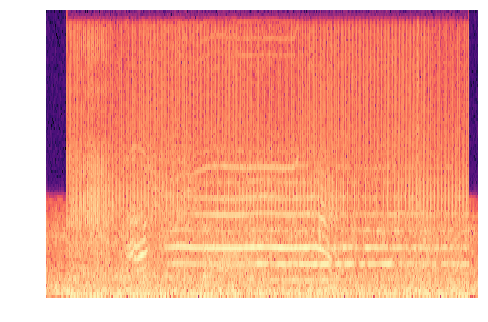

In [13]:
import numpy as np
import math

for n in range(s, s*2):
    randNum = np.random.randint(0, len(files))
    file = files[randNum]
    positive_train_labels[n] = int(label_to_num[labelDict[str(randNum)]])
    audio = AudioSegment.from_wav("./smolpositive/"+file)
#     audio +=20
    if len(audio) >= 1000:
        if len(audio) != 1000:
            segment_start, segment_end = get_random_time_segment(len(audio), 1000)
            audio = audio[segment_start:segment_end]
            audio.export("./newData/audio/positive/"+str(n)+".wav", format='wav')
        else:
            audio.export("./newData/audio/positive/"+str(n)+".wav", format='wav')
    else:
        random_BG_file = bgs[np.random.randint(0, len(bgs))]
        background = AudioSegment.from_wav("./finalData/backgrounds/"+random_BG_file)
#         background = background - 20
        if len(audio) >850:
            b = math.floor(np.random.uniform(0, 0.3)*len(audio))
            while b == 0:
                b = math.floor(np.random.uniform(0, 0.3)*len(audio))
            st = np.random.randint(0, b)
            audio = audio[st:]

        audio, _ = insert_audio_clip(background, audio)
        audio.export("./newData/audio/positive/"+str(n)+".wav", format='wav')
    if not os.path.exists("./newData/images/intermediateData/"):
        os.makedirs("./newData/images/intermediateData/")
    
    P, freqs, bins = graph_spectrogram("./newData/audio/positive/"+str(n)+".wav")
    positive_train_specGram_array[n] = P.T

**For third type of positive data we have to re-define `insert_audio_clip()` function first.**

In [14]:
import random
def insert_audio_clip2(background, audio_clip):
    segment_ms = len(audio_clip)
    c = random.choice([True, False])
    if c == True:
        pos = 0
    else:
        pos = len(background) - len(audio_clip)
    new_background = background.overlay(audio_clip, position=pos)
    return new_background, None

C:\Users\Babban\AppData\Local\conda\conda\envs\tensorflow\lib\site-packages\matplotlib\pyplot.py:522: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


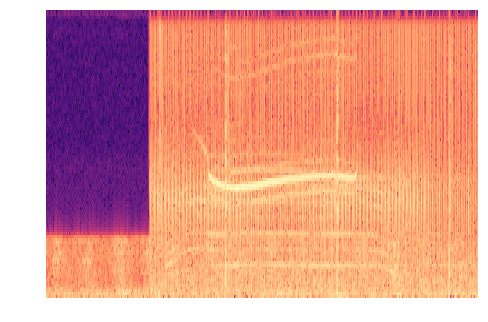

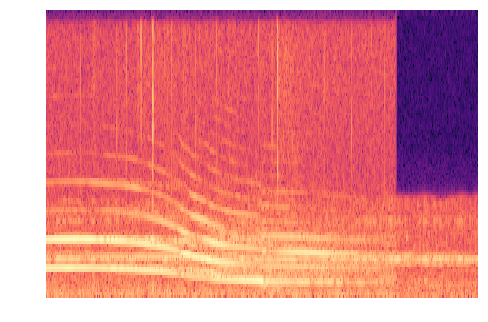

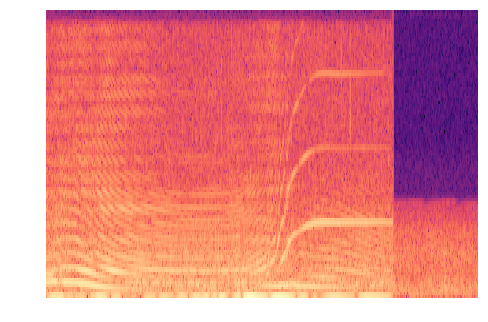

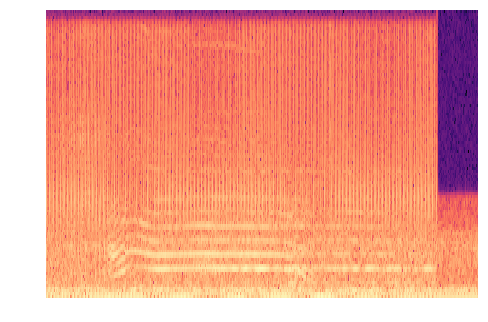

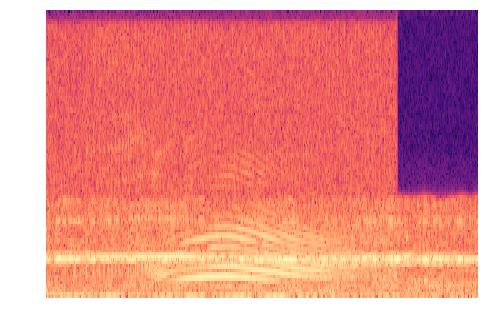

...

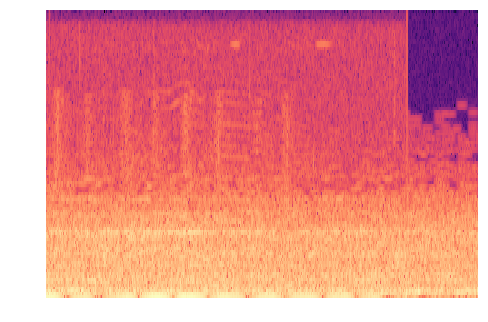

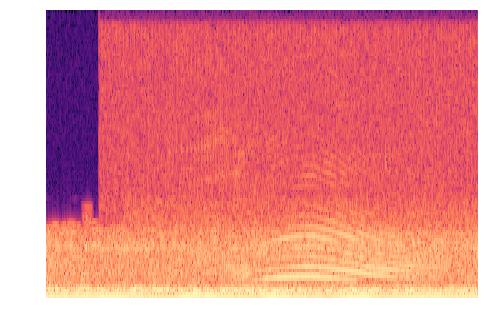

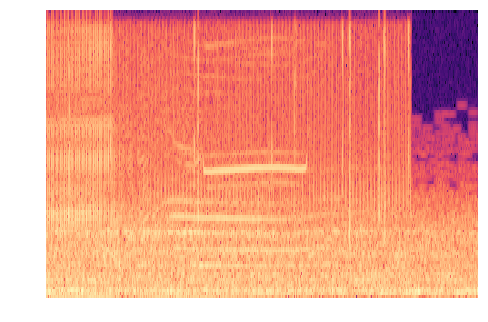

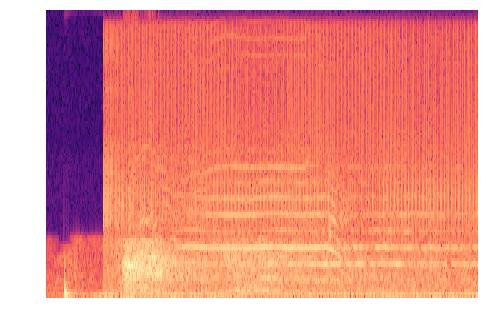

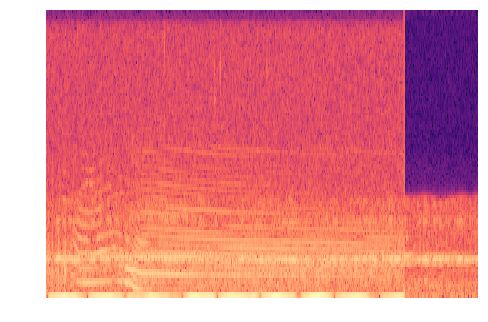

In [15]:
import numpy as np
import math

for n in range(s*2, s*3):
    randNum = np.random.randint(0, len(files))
    file = files[randNum]
    positive_train_labels[n] = int(label_to_num[labelDict[str(randNum)]])
    audio = AudioSegment.from_wav("./smolpositive/"+file)
#     audio +=20
    if len(audio) >= 1000:
        if len(audio) != 1000:
            segment_start, segment_end = get_random_time_segment(len(audio), 1000)
            audio = audio[segment_start:segment_end]
            audio.export("./newData/audio/positive/"+str(n)+".wav", format='wav')
        else:
            audio.export("./newData/audio/positive/"+str(n)+".wav", format='wav')
    else:
        random_BG_file = bgs[np.random.randint(0, len(bgs))]
        background = AudioSegment.from_wav("./finalData/backgrounds/"+random_BG_file)
#         background = background - 20
        if len(audio) >850:
            b = math.floor(np.random.uniform(0, 0.3)*len(audio))
            if b != 0:
                st = np.random.randint(0, b)
            else:
                st = b
            audio = audio[st:]

        audio, _ = insert_audio_clip2(background, audio)
        audio.export("./newData/audio/positive/"+str(n)+".wav", format='wav')
    if not os.path.exists("./newData/images/intermediateData/"):
        os.makedirs("./newData/images/intermediateData/")
    
    P, freqs, bins = graph_spectrogram("./newData/audio/positive/"+str(n)+".wav")
    positive_train_specGram_array[n] = P.T

In [16]:
# Saves all types of positive data in same directory
from keras.utils import to_categorical
positive_train_encoded = to_categorical(positive_train_labels, num_classes=8)
np.save("./newData/audio/positive/labels.npy", positive_train_encoded)
np.save("./newData/audio/positive/specGrams.npy", positive_train_specGram_array)

### Load packages and generated data

In [17]:
import numpy as np
import keras
import os
import matplotlib.pyplot as plt
from keras.callbacks import EarlyStopping, TensorBoard, ModelCheckpoint
from keras.layers import Dense, Input, BatchNormalization, Conv1D, Dropout, Activation, LSTM
from keras.models import Model
from keras.models import load_model
import time

In [18]:
X_train = np.append(np.load("newData/audio/positive/specGrams.npy"), np.load("newData/audio/negative/specGrams.npy"), axis=0)
Y_train = np.append(np.load("newData/audio/positive/labels.npy"), np.load("newData/audio/negative/labels.npy"), axis=0)

## RNN model 1
It is a simple RNN model which takes spectrograms as inputs and classifies the orca calls. Model has two conv1D layers and one LSTM layer. Classification is done using `Softmax` layer.

In [19]:
def get_model(input_shape):
    
    X_input = Input(shape = input_shape)
    
    X = Conv1D(64, 15, strides=4)(X_input)                                 
    X = Conv1D(128, 15, strides=4)(X) 
    X = BatchNormalization()(X)                            
    X = Activation('relu')(X)                                 
    
    
    X = LSTM(units = 128, return_sequences = False)(X)  
    X = Dropout(0.3)(X)                                 
    X = BatchNormalization()(X)                              
    
    X = Dense(8, activation = "softmax")(X) 

    model = Model(inputs = X_input, outputs = X)
    
    return model

In [20]:
model = get_model((549, 101))

In [21]:
model.summary()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         (None, 549, 101)          0         
_________________________________________________________________
conv1d_1 (Conv1D)            (None, 134, 64)           97024     
_________________________________________________________________
conv1d_2 (Conv1D)            (None, 30, 128)           123008    
_________________________________________________________________
batch_normalization_1 (Batch (None, 30, 128)           512       
_________________________________________________________________
activation_1 (Activation)    (None, 30, 128)           0         
_________________________________________________________________
lstm_1 (LSTM)                (None, 128)               131584    
_________________________________________________________________
dropout_1 (Dropout)          (None, 128)               0         
__________

In [22]:
model.compile(loss="categorical_crossentropy", optimizer="adam", metrics=["accuracy"])

In [23]:
model.fit(X_train, Y_train, epochs=300, batch_size=8, shuffle=True)

Epoch 1/300
340/340 [==============================] - 5s 15ms/step - loss: 2.0826 - acc: 0.3206
Epoch 2/300
340/340 [==============================] - 3s 9ms/step - loss: 1.5295 - acc: 0.4912
Epoch 3/300
340/340 [==============================] - 3s 8ms/step - loss: 1.2600 - acc: 0.5794
Epoch 4/300
340/340 [==============================] - 3s 9ms/step - loss: 1.1983 - acc: 0.5941
Epoch 5/300
340/340 [==============================] - 3s 9ms/step - loss: 1.0087 - acc: 0.6676
Epoch 6/300
340/340 [==============================] - 3s 8ms/step - loss: 1.0452 - acc: 0.6559
Epoch 7/300
340/340 [==============================] - 2s 7ms/step - loss: 0.8232 - acc: 0.7059
Epoch 8/300
340/340 [==============================] - 2s 7ms/step - loss: 0.8275 - acc: 0.7353
Epoch 9/300
340/340 [==============================] - 2s 7ms/step - loss: 0.7997 - acc: 0.7471
Epoch 10/300
340/340 [==============================] - 2s 7ms/step - loss: 0.7862 - acc: 0.7324
Epoch 11/300
340/340 [================

340/340 [==============================] - 2s 7ms/step - loss: 0.0605 - acc: 0.9912
Epoch 168/300
340/340 [==============================] - 2s 7ms/step - loss: 0.0282 - acc: 0.9912
Epoch 169/300
340/340 [==============================] - 2s 7ms/step - loss: 0.0722 - acc: 0.9765
Epoch 170/300
340/340 [==============================] - 2s 7ms/step - loss: 0.1296 - acc: 0.9794
Epoch 171/300
340/340 [==============================] - 2s 7ms/step - loss: 0.0421 - acc: 0.9882
Epoch 172/300
340/340 [==============================] - 2s 7ms/step - loss: 0.0240 - acc: 0.9941
Epoch 173/300
340/340 [==============================] - 2s 7ms/step - loss: 0.0067 - acc: 1.0000
Epoch 174/300
340/340 [==============================] - 3s 7ms/step - loss: 0.0101 - acc: 0.9971
Epoch 175/300
340/340 [==============================] - 2s 7ms/step - loss: 0.0497 - acc: 0.9912
Epoch 176/300
340/340 [==============================] - 2s 7ms/step - loss: 0.0543 - acc: 0.9853
Epoch 177/300
340/340 [===========

## RNN model 2
This structure of model is similar to RNN model 1. But the difference here is that insted of spectrograms it takes raw audio rata as input.

Since, values of Audio data varies very much. First I will scale the data so that our model will converge faster.
Let's start by standardizing the channels of our generated data.

In [24]:
for i in os.listdir("./newData/audio/positive/"):
    if i.endswith(".wav"):
        aud = AudioSegment.from_wav("./newData/audio/positive/"+i)
        aud = aud.set_channels(1)
        aud.export("./newData/audio/positive/"+i, format="wav")

In [25]:
for i in os.listdir("./newData/audio/negative/"):
    if i.endswith(".wav"):
        aud = AudioSegment.from_wav("./newData/audio/negative/"+i)
        aud = aud.set_channels(1)
        aud.export("./newData/audio/negative/"+i, format="wav")

In [26]:
# It will store the training data
X_raw = np.zeros((X_train.shape[0], 44100))

Now load positive and negative data into our array.

In [27]:
for i in range(300):
    rate, data = wavfile.read("./newData/audio/positive/"+str(i)+".wav")
    X_raw[i] = data[:]

In [28]:
for j in range(40):
    i += 1
    rate, data = wavfile.read("./newData/audio/negative/"+str(j)+".wav")
    X_raw[i] = data[:]

Scale the values of our array using `sklearn` library.

In [29]:
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
X_raw = scaler.fit_transform(X_raw)

In [30]:
def get_model(input_shape):
    
    X_input = Input(shape = input_shape)
    
    X = Conv1D(64, 50, strides=50)(X_input)                                 # CONV1D
    X = Conv1D(64, 50, strides=50)(X) 
    X = BatchNormalization()(X)                            # Batch normalization
    X = Activation('relu')(X)                                 # ReLu activation
    
    
    X = LSTM(units = 32, return_sequences = False)(X)  # LSTM(use 128 units and return the sequences)
    X = Dropout(0.3)(X)                                 # dropout (use 0.8)
    X = BatchNormalization()(X)                                 # Batch normalization
    
    X = Dense(8, activation = "softmax")(X) 
    model = Model(inputs = X_input, outputs = X)
    
    return model

In [31]:
model = get_model((44100, 1))

In [32]:
model.summary()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_2 (InputLayer)         (None, 44100, 1)          0         
_________________________________________________________________
conv1d_3 (Conv1D)            (None, 882, 64)           3264      
_________________________________________________________________
conv1d_4 (Conv1D)            (None, 17, 64)            204864    
_________________________________________________________________
batch_normalization_3 (Batch (None, 17, 64)            256       
_________________________________________________________________
activation_2 (Activation)    (None, 17, 64)            0         
_________________________________________________________________
lstm_2 (LSTM)                (None, 32)                12416     
_________________________________________________________________
dropout_2 (Dropout)          (None, 32)                0         
__________

In [33]:
model.compile(loss="categorical_crossentropy", optimizer="adam", metrics=["accuracy"])

In [34]:
model.fit(X_raw.reshape(340, 44100, 1), Y_train, epochs=300, batch_size=8, shuffle=True)

Epoch 1/300
340/340 [==============================] - 5s 14ms/step - loss: 2.1958 - acc: 0.2676
Epoch 2/300
340/340 [==============================] - 1s 4ms/step - loss: 1.6350 - acc: 0.4176
Epoch 3/300
340/340 [==============================] - 1s 4ms/step - loss: 1.3794 - acc: 0.5206A: 0s - loss: 1.3818 - acc: 0
Epoch 4/300
340/340 [==============================] - 2s 5ms/step - loss: 1.2662 - acc: 0.5882
Epoch 5/300
340/340 [==============================] - 1s 4ms/step - loss: 1.0374 - acc: 0.6765
Epoch 6/300
340/340 [==============================] - 2s 5ms/step - loss: 0.9963 - acc: 0.6853
Epoch 7/300
340/340 [==============================] - 2s 5ms/step - loss: 0.8077 - acc: 0.7147
Epoch 8/300
340/340 [==============================] - 1s 4ms/step - loss: 0.7505 - acc: 0.7647
Epoch 9/300
340/340 [==============================] - 1s 4ms/step - loss: 0.6985 - acc: 0.8059
Epoch 10/300
340/340 [==============================] - 2s 4ms/step - loss: 0.7111 - acc: 0.7794
Epoch 11/

340/340 [==============================] - 1s 4ms/step - loss: 0.0292 - acc: 0.9912
Epoch 168/300
340/340 [==============================] - 1s 4ms/step - loss: 0.0285 - acc: 0.9912
Epoch 169/300
340/340 [==============================] - 1s 4ms/step - loss: 0.0246 - acc: 0.9971
Epoch 170/300
340/340 [==============================] - 1s 4ms/step - loss: 0.0240 - acc: 0.9941
Epoch 171/300
340/340 [==============================] - 1s 4ms/step - loss: 0.0244 - acc: 0.9853
Epoch 172/300
340/340 [==============================] - 1s 4ms/step - loss: 0.0110 - acc: 0.9971
Epoch 173/300
340/340 [==============================] - 1s 4ms/step - loss: 0.0358 - acc: 0.9882
Epoch 174/300
340/340 [==============================] - 1s 4ms/step - loss: 0.0133 - acc: 1.0000
Epoch 175/300
340/340 [==============================] - 1s 4ms/step - loss: 0.0095 - acc: 1.0000
Epoch 176/300
340/340 [==============================] - 1s 4ms/step - loss: 0.0127 - acc: 0.9971
Epoch 177/300
340/340 [===========

# Results:

Both the model got around 100% accuracy without any data augmentation. Dataset was very small to test or validate the training of model.

With enough data I can use data augmentation to improve the performance of model.